# Border Limits

9 July, 2024

@roman

In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from tqdm import tqdm
import h3
import os

from scipy.spatial import KDTree
import scipy.sparse as sp
from scipy import io
from sklearn.cluster import MiniBatchKMeans, SpectralClustering, HDBSCAN
from INEGIpy import MarcoGeoestadistico

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


In [2]:
# Settings
# show 100 columns in pandas
pd.set_option('display.max_columns', 100)
geo_framework = MarcoGeoestadistico()

---
# Data

## Properties

In [3]:
# read parquet
gdf_properties = pd.read_parquet("../../data/interim/cleaned_data_s5.parquet")

# to geopandas
gdf_properties = gpd.GeoDataFrame(
    gdf_properties,
    geometry=gpd.points_from_xy(gdf_properties['longitude'], gdf_properties['latitude']),
    crs="EPSG:4326"
    )

# change crs to 6372
gdf_properties = gdf_properties.to_crs("EPSG:6372")

gdf_properties.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 1908483 entries, 0 to 1909137
Data columns (total 58 columns):
 #   Column                              Dtype         
---  ------                              -----         
 0   half_bathrooms                      uint8         
 1   full_bathrooms                      uint8         
 2   property_class_more_common_in_area  string        
 3   neighborhood                        string        
 4   constructor                         string        
 5   zip_code                            uint32        
 6   age_in_months                       uint8         
 7   parking_lots                        uint8         
 8   valuation_date                      datetime64[ns]
 9   potable_water_service_id            float64       
 10  lighting_service_id                 float64       
 11  sidewalk_id                         float64       
 12  project_quality_id                  float64       
 13  property_class_id                   uin

## Ocean Geometries

In [4]:
# read ocean geometries
gdf_mexico_oceans = gpd.read_file("../../data/catalogues/mexico_shapes/regionmarinamx")

# vars 2 stay
vars_to_stay = [
    'etiqueta', 'geometry'
]

# normalize etiqueta: remove special characters of latin to utf8
gdf_mexico_oceans['etiqueta'] = gdf_mexico_oceans['etiqueta'].str.normalize('NFKD').str.encode('ascii', errors='ignore').str.decode('utf-8')
# to lower and trim
gdf_mexico_oceans['etiqueta'] = gdf_mexico_oceans['etiqueta'].str.lower().str.strip()
# replace spaces with _
gdf_mexico_oceans['etiqueta'] = gdf_mexico_oceans['etiqueta'].str.replace(" ", "_")

# get only vars to stay
gdf_mexico_oceans = gdf_mexico_oceans[vars_to_stay]

# see
print(gdf_mexico_oceans.shape)
gdf_mexico_oceans

(5, 2)


,etiqueta,geometry
0,mar_caribe,"MULTIPOLYGON (((-87.84135 18.24767, -87.84300 ..."
1,golfo_de_california,"POLYGON ((-110.82716 27.95587, -110.82710 27.9..."
2,pacifico_noroeste,"POLYGON ((-117.25925 32.60027, -117.21526 32.5..."
3,pacifico_tropical,"POLYGON ((-105.67655 20.34785, -105.67643 20.3..."
4,golfo_de_mexico,"POLYGON ((-93.39727 25.97991, -93.41794 25.806..."


<Axes: >

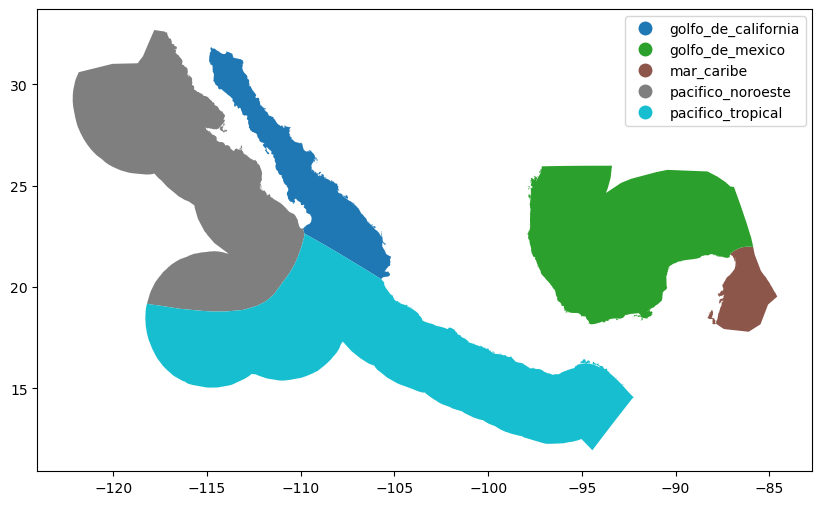

In [5]:
# plot ocean geometries color by REGIONMAR
gdf_mexico_oceans.plot(column="etiqueta", legend=True, figsize=(10, 10))

In [6]:
# buffer ocean geometries 2 km
gdf_mexico_oceans_buffered = gdf_mexico_oceans.copy()

# change to crs 6372
gdf_mexico_oceans_buffered = gdf_mexico_oceans_buffered.to_crs("EPSG:6372")
gdf_mexico_oceans_buffered["geometry"] = gdf_mexico_oceans_buffered["geometry"].buffer(1_000)

# plot ocean geometries color by REGIONMAR
gdf_mexico_oceans_buffered.explore(column="etiqueta", legend=True, figsize=(10, 10))

## Mexico Borders (WIP)

In [7]:
# # get mexico shape
# gdf_mex_states = geo_framework.Entidades()
# gdf_mex_states.plot()

In [8]:
# # get only the contours of mexico
# gdf_mex_boundary = gdf_mex_states.unary_union
# gdf_mex_boundary = gpd.GeoDataFrame(geometry=[gdf_mex_boundary], crs="EPSG:4236")
# gdf_mex_boundary = gdf_mex_boundary.boundary
# gdf_mex_boundary = gpd.GeoDataFrame(geometry=gdf_mex_boundary, crs="EPSG:4236")

In [9]:
# # plot
# gdf_mex_boundary.plot()

In [10]:
# # buffer mexico boundary 2 km
# gdf_mex_boundary_buffered = gdf_mex_boundary.copy()
# gdf_mex_boundary_buffered = gdf_mex_boundary_buffered.to_crs("EPSG:6372")
# gdf_mex_boundary_buffered["geometry"] = gdf_mex_boundary_buffered["geometry"].buffer(1_000)
# gdf_mex_boundary_buffered.plot()

---
# Match Properties

## Find properties near Ocean

In [11]:
from shapely.ops import unary_union

def find_within_buffer(gdf_objective, gdf_oceans, buffer_size, crs="EPSG:6372"):
    """
    Find rows in the objective GeoDataFrame that are within the buffer of the geometries in another GeoDataFrame.

    Parameters:
    gdf_objective (GeoDataFrame): The GeoDataFrame containing the target geometries.
    gdf_oceans (GeoDataFrame): The GeoDataFrame containing the geometries to buffer.
    buffer_size (float): The size of the buffer in the units of the specified CRS.
    crs (str): The coordinate reference system to project the geometries to. Default is "EPSG:6372".

    Returns:
    GeoDataFrame: The rows in the objective GeoDataFrame that are within the buffered polygon.
    """
    # Copy
    gdf_objective = gdf_objective.copy()

    # Set the coordinate reference system to the specified CRS
    gdf_oceans = gdf_oceans.to_crs(crs)
    vars_to_stay = [
        "observation_id", "geometry"
    ]
    gdf_objective = (
        gdf_objective
        .to_crs(crs)
        .loc[:, vars_to_stay]
        )

    # Buffer gdf_oceans
    buffered_boundary_gdf = gdf_oceans.copy()
    buffered_boundary_gdf["geometry"] = buffered_boundary_gdf["geometry"].buffer(buffer_size)

    # Perform a spatial join to find rows in gdf_objective that intersect with the buffered geometry
    within_buffer_gdf = gpd.sjoin(
        gdf_objective, 
        buffered_boundary_gdf,
        predicate="within"
        )

    # If repeated rows are found, keep only the first occurrence
    within_buffer_gdf = (
        within_buffer_gdf
        .sort_values(["observation_id", "etiqueta"])
        .drop_duplicates(subset="observation_id", keep="first")
        .reset_index(drop=True)
        )

    # drop index_right
    within_buffer_gdf = within_buffer_gdf.drop(columns="index_right")

    return within_buffer_gdf

# find properties within ocean buffer
list_distances = [50_000, 10_000, 2_000, 500]
list_gdf_properties = []
for distance in tqdm(list_distances):
    gdf_properties_buffered = find_within_buffer(gdf_properties, gdf_mexico_oceans, distance)
    gdf_properties_buffered["distance_to_ocean"] = distance
    list_gdf_properties.append(gdf_properties_buffered)


100%|██████████| 4/4 [01:00<00:00, 15.08s/it]


In [12]:
# concat both and get unique properties
gdf_properties_at_beach = (
    pd.concat(list_gdf_properties, ignore_index=True)
    .sort_values("distance_to_ocean", ascending=True)
    .drop_duplicates(subset="observation_id", keep="first")
    .reset_index(drop=True)
)

# see 
print(gdf_properties_at_beach.shape)
gdf_properties_at_beach.head()

(413200, 4)


,observation_id,geometry,etiqueta,distance_to_ocean
0,fffe570f-8629-4df4-8cf0-aa3c2c4f42df,POINT (3117874.010 809380.810),golfo_de_mexico,500
1,56d0c849-410c-40b2-b9ed-fe31ec4abf46,POINT (3569782.016 778072.321),golfo_de_mexico,500
2,56d03c74-800a-4488-b7e5-6c2a55425c58,POINT (2723173.746 540646.132),pacifico_tropical,500
3,56c3da4f-4b8f-4cd1-8373-f4130c136722,POINT (2724355.335 543179.401),pacifico_tropical,500
4,56b608a9-19f2-41b9-a743-edb51f501309,POINT (3573779.304 778536.782),golfo_de_mexico,500


In [13]:
# count
gdf_properties_at_beach["distance_to_ocean"].value_counts(normalize=True)

distance_to_ocean
50000    0.472940
10000    0.410271
2000     0.086389
500      0.030399
Name: proportion, dtype: float64

In [14]:
# count etiqueta
gdf_properties_at_beach["etiqueta"].value_counts(normalize=True)

etiqueta
golfo_de_mexico        0.401985
golfo_de_california    0.295760
mar_caribe             0.152193
pacifico_tropical      0.102667
pacifico_noroeste      0.047396
Name: proportion, dtype: float64

In [15]:
# explore
(
    gdf_properties_at_beach
    .query("distance_to_ocean <= 2_000")
    .explore(column="distance_to_ocean", legend=True, tiles="cartodbpositron")
)

## Add column to gdf_properties

In [16]:
# add distance_to_ocean and etiqueta to gdf_properties
gdf_properties = (
    gdf_properties
    .merge(
        gdf_properties_at_beach[["observation_id", "distance_to_ocean", "etiqueta"]],
        on="observation_id",
        how="left"
    )
    .rename(columns={"etiqueta": "ocean_label"})
    .assign(
        distance_to_ocean=lambda x: x["distance_to_ocean"].fillna(np.inf),
        ocean_label=lambda x: x["ocean_label"].fillna("no_ocean")
    )
)

# see size
print(gdf_properties.shape)

(1908483, 60)


In [17]:
# see if any observation_id is duplicated
gdf_properties["observation_id"].duplicated().sum()

0

---
# Save

In [18]:
# see cols
gdf_properties.columns

Index(['half_bathrooms', 'full_bathrooms',
       'property_class_more_common_in_area', 'neighborhood', 'constructor',
       'zip_code', 'age_in_months', 'parking_lots', 'valuation_date',
       'potable_water_service_id', 'lighting_service_id', 'sidewalk_id',
       'project_quality_id', 'property_class_id', 'conservation_status_id',
       'controller_id', 'elevator_service_id', 'state_id', 'equipment_id',
       'curb_id', 'infrastructure_service_id', 'road_materials_id',
       'municipality_id', 'grantor_id', 'urban_proximity_id',
       'water_collection_service_id', 'electrical_supply_service_id',
       'telephone_service_supply_id', 'property_type_id',
       'public_transportation_service_id', 'valuation_unit_id',
       'valuation_professional_id', 'latitude', 'longitude', 'level',
       'total_levels', 'purpose_of_appraisal', 'bedrooms', 'built_area',
       'saleable_area', 'land_area', 'rentable_units',
       'rentable_units_subject_property', 'current_use', 'market_pr

In [19]:
# save
gdf_properties.to_parquet("../../data/interim/cleaned_data_s7.parquet")